# Visualisation de réseaux de neurones

                                Valentyn Gerushta, Léane Salais

Tenter de justifier les choix de classification en faisant apparaître des repères de décision.

## Fonctions et variables utiles

In [1]:
import torch
import torchvision
from torchvision import transforms
import random
import numpy as np
from scipy.ndimage.filters import gaussian_filter1d
import matplotlib.pyplot as plt
from PIL import Image
import os

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'viridis'

### Preprocessing 

Rescaling éventuel et normalisation des images 

In [2]:
SQUEEZENET_MEAN = np.array([0.485, 0.456, 0.406], dtype=np.float32)
SQUEEZENET_STD = np.array([0.229, 0.224, 0.225], dtype=np.float32)

def preprocess(img, size=224):
    transform = transforms.Compose([
        transforms.Resize((size,size)),
        transforms.ToTensor(),
        transforms.Normalize(mean=SQUEEZENET_MEAN.tolist(),
                    std=SQUEEZENET_STD.tolist()),
        transforms.Lambda(lambda x: x[None]),  # add one dimension
    ])
    return transform(img)

def deprocess(img, should_rescale=True):
    transform = transforms.Compose([
        transforms.Lambda(lambda x: x[0]),
        transforms.Normalize(mean=[0, 0, 0], std=(1.0 / SQUEEZENET_STD).tolist()),
        transforms.Normalize(mean=(-SQUEEZENET_MEAN).tolist(), std=[1, 1, 1]),
        transforms.Lambda(rescale) if should_rescale else transforms.Lambda(lambda x: x),
        transforms.ToPILImage(),
    ])
    return transform(img)

def rescale(x):
    low, high = x.min(), x.max()
    x_rescaled = (x - low) / (high - low)
    return x_rescaled
    
def blur_image(X, sigma=1):
    X_np = X.cpu().clone().detach().numpy()
    X_np = gaussian_filter1d(X_np, sigma, axis=2)
    X_np = gaussian_filter1d(X_np, sigma, axis=3)
    X.copy_(torch.Tensor(X_np).type_as(X))
    return X

def jitter(X, ox, oy):
    """
    Helper function to randomly jitter an image.
    Inputs
    - X: PyTorch Tensor of shape (N, C, H, W)
    - ox, oy: Integers giving number of pixels to jitter along W and H axes
    Returns: A new PyTorch Tensor of shape (N, C, H, W)
    """
    if ox != 0:
        left = X[:, :, :, :-ox]
        right = X[:, :, :, -ox:]
        X = torch.cat([right, left], dim=3)
    if oy != 0:
        top = X[:, :, :-oy]
        bottom = X[:, :, -oy:]
        X = torch.cat([bottom, top], dim=2)
    return X

### Chargement des modèles

Pour ce TME, on utilisera le modèle Squeezenet qui est léger et pré-appris sur ImageNet. Ce modèle sera figé puisque le but n'est pas de modifier/apprendre ses poids mais de les étudier.

In [3]:
# Chargement du modèle
squeeze = torchvision.models.squeezenet1_1(pretrained=True)
squeeze.eval()
for param in squeeze.parameters():
    param.requires_grad = False
squeeze

Downloading: "https://download.pytorch.org/models/squeezenet1_1-f364aa15.pth" to /root/.cache/torch/hub/checkpoints/squeezenet1_1-f364aa15.pth


SqueezeNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (3): Fire(
      (squeeze): Conv2d(64, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (4): Fire(
      (squeeze): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (5): MaxPool2d

Addendum : usage de VGG16 et VGG19 pour les bonus

In [4]:
# Loading the model
vgg16 = torchvision.models.vgg16(pretrained=True)
vgg16.eval()
for param in vgg16.parameters():
    param.requires_grad = False
# Showing its structure
vgg16

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [5]:
vgg19 = torchvision.models.vgg19(pretrained=True)
vgg19.eval()
for param in vgg19.parameters():
    param.requires_grad = False
vgg19

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

### Chargement d'images d'exemples

Permet de charger dans les variables `X, y, class_names` 25 exemples de l'ensemble de validation d'ImageNet. `X` contient les images, `y` l'indice de la classe de chacune, et `class_names` un dictionnaire permettant d'obtenir le nom d'une classe à partir de son numéro.

In [6]:
# Download data
!wget https://github.com/cdancette/deep-learning-polytech-tp6-7/raw/master/tp9/imagenet_val_25.npz

--2021-01-16 20:15:09--  https://github.com/cdancette/deep-learning-polytech-tp6-7/raw/master/tp9/imagenet_val_25.npz
Resolving github.com (github.com)... 140.82.112.4
Connecting to github.com (github.com)|140.82.112.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/cdancette/deep-learning-polytech-tp6-7/master/tp9/imagenet_val_25.npz [following]
--2021-01-16 20:15:09--  https://raw.githubusercontent.com/cdancette/deep-learning-polytech-tp6-7/master/tp9/imagenet_val_25.npz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3940548 (3.8M) [application/octet-stream]
Saving to: ‘imagenet_val_25.npz’

imagenet_val_25.npz 100%[===================>]   3.76M  --.-KB/s    in 0.04s   

2021-01-16 20:15:10 (98.1

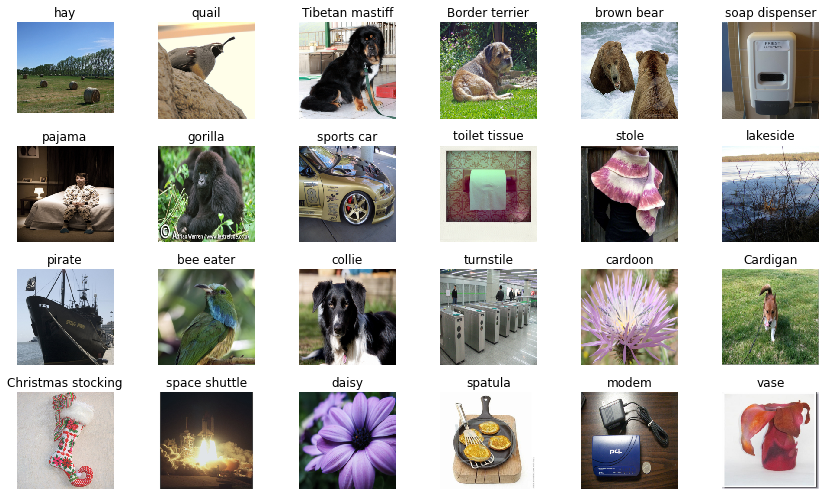

In [7]:
f = np.load("imagenet_val_25.npz", allow_pickle=True)
X, y, class_names = f["X"], f["y"], f["label_map"].item()
class_names_to_id = {name: id for id, name in class_names.items()}

plt.figure(figsize=(12,7))
for i in range(24):
    plt.subplot(4, 6, i+1)
    plt.imshow(X[i])
    # Just a display trick
    plt.title(class_names[y[i]].split(',')[0])
    plt.axis('off')
plt.gcf().tight_layout()

## Saliency Maps

Calculez la carte de saillance pour 5 exemples parmi les 25 chargés.

**Conseil :** Pour sélectionner 1 valeur particulière pour chaque ligne d'une matrice, vous pouvez faire comme cela :

```python
x = torch.Tensor([[0.1, 0.0, 0.5, 0.1, 0.1],
                  [0.0, 0.1, 0.0, 0.6, 0.2],
                  [0.7, 0.1, 0.1, 0.3, 0.0]])
x[np.arange(3), [2, 3, 0]]
# 0.5000
# 0.6000
# 0.7000
#[torch.FloatTensor of size 3]
```

In [ ]:
def compute_saliency_maps(X, y, model):
    """
    Compute a class saliency map using the model for images X and labels y.
    Input:
    - X: Input images; Tensor of shape (N, 3, H, W)
    - y: Labels for X; LongTensor of shape (N,)
    - model: A pretrained CNN that will be used to compute the saliency map.
    Returns:
    - saliency: A Tensor of shape (N, H, W) giving the saliency maps for the input
    images.
    """
    # activate gradients on X
    X.requires_grad = True
    saliency = None
    ##############################################################################
    # Perform a forward and backward pass through the model to compute the       #
    # gradient of the correct class score with respect to each input image.      #
    # You first want to extract the logits for the correct scores (not the loss) #
    # and then compute the gradients with a backward pass.                       #
    ##############################################################################
    preds = model(X) # (N,1000)
    # Get the right classes' scores for all images in the batch
    interesting_logits = preds[torch.arange(len(y)),y] 
    assert interesting_logits.shape == y.shape
    # interesting_logits.backward(torch.ones(len(y))) # ligne équivalente
    interesting_logits.sum().backward()     
    # =/= wrt classic backwards : ONLY THE CORRECT CLASS SCORE

    # Get the maximal responses in each image's gradient
    saliency = torch.max(torch.abs(X.grad),dim=1)[0]
    pred = [class_names[torch.argmax(preds,dim=1)[i].item()] for i in range(preds.shape[0])]
    ##############################################################################
    #                             END OF YOUR CODE                               #
    ##############################################################################
    return saliency, pred

def show_saliency_maps(X, y, model):
    # Convert X and y from numpy arrays to Torch Tensors
    X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
    y_tensor = torch.LongTensor(y)
    # Compute saliency maps for images in X
    saliency,pred = compute_saliency_maps(X_tensor, y_tensor, model)
    # print("here", saliency.shape, X_tensor.shape)
    # Convert the saliency map from Torch Tensor to numpy array and show images
    # and saliency maps together.
    saliency = saliency.numpy()
    N = X.shape[0]
    for i in range(N):
        plt.subplot(2, N, i+1)
        plt.imshow(X[i])
        plt.axis('off')
        plt.title(pred[i].split(',')[0]+'\n'+ r"$\bf{"+class_names[y[i]].split(',')[0]+"}$")
        plt.subplot(2, N, N+i+1)
        plt.imshow(saliency[i], cmap=plt.cm.hot)
        plt.axis('off')
        plt.gcf().set_size_inches(12, 5)
    plt.show()

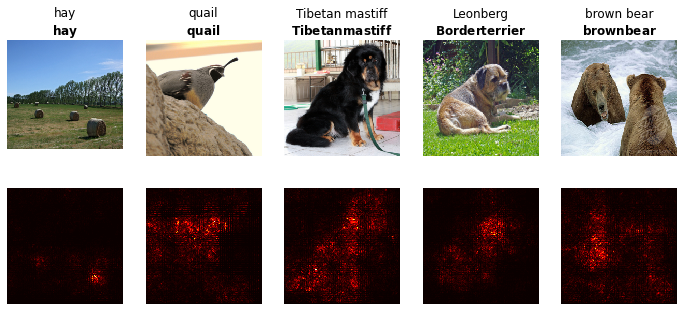

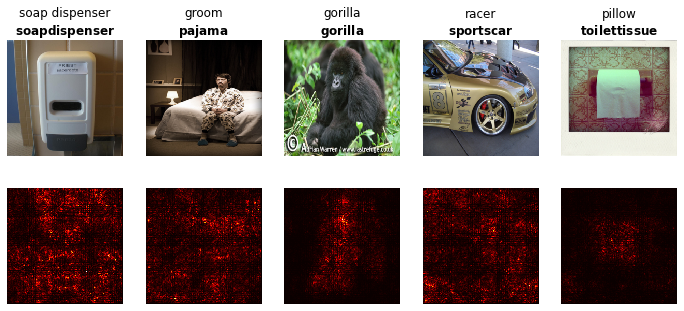

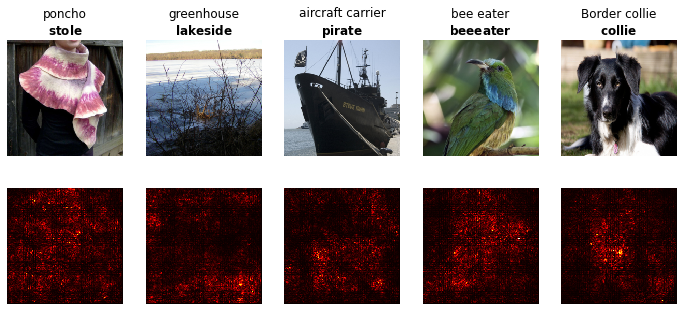

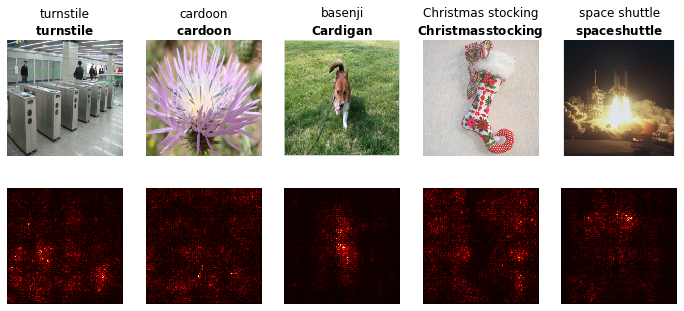

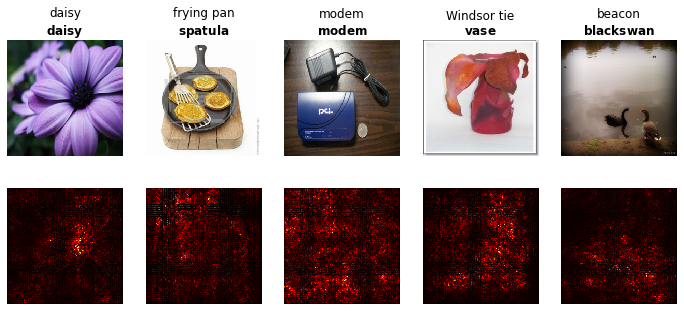

In [ ]:
for i in range(5): # range(5) pour tester toutes les images
    show_saliency_maps(X[5*i:5*i+5], y[5*i:5*i+5], squeeze)

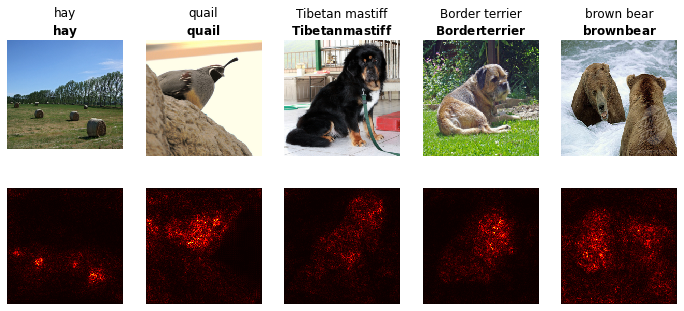

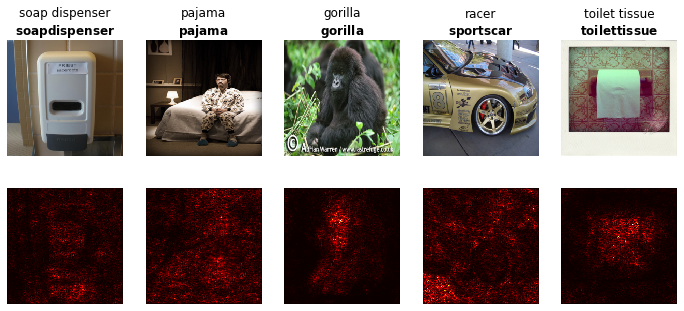

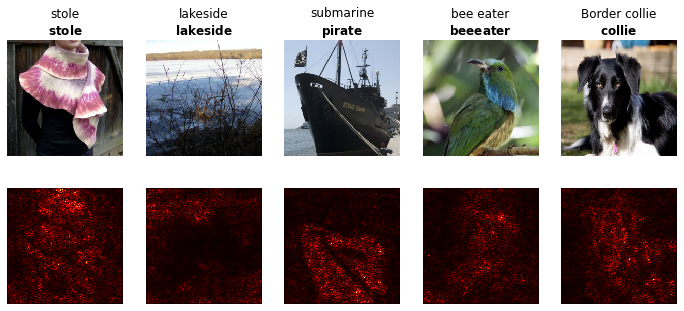

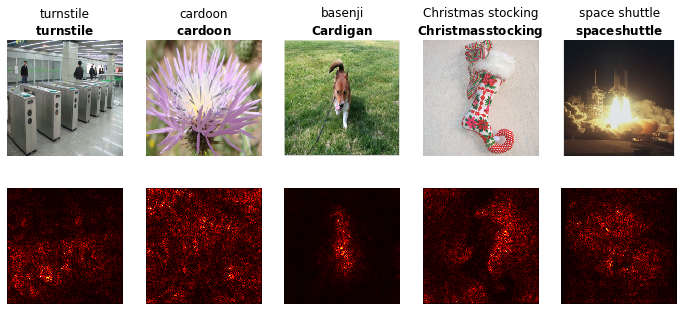

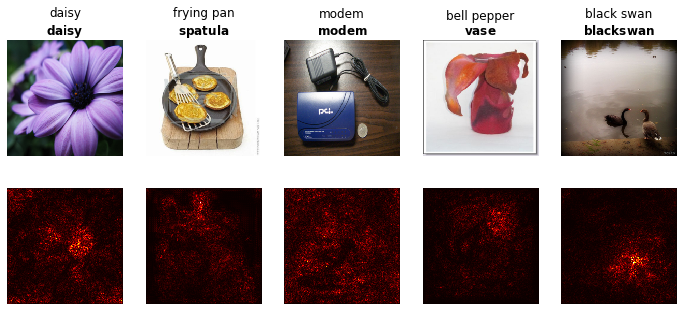

In [ ]:
# Trying with VGG16
for i in range(5):
    show_saliency_maps(X[5*i:5*i+5], y[5*i:5*i+5], vgg16)

https://arxiv.org/pdf/2002.00772.pdf

## Fooling Images

Calculez une image de facon à ce qu'elle soit classée dans une classe `target_y` autre que la classe réelle (en modifiant l'image et pas les poids du réseau).

### Premiers essais 

**Les 2 premiers blocs permettent de faire des tests de facon interactive** pour écrire votre code. Une fois que votre code semble fonctionner, compléter la fonction dans le 3e bloc et tester sur differentes images avec le 4e bloc.

In [ ]:
# Init test
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[0])))
target_y = class_names_to_id['stingray'] # Target class
X_fooling = X_tensor.clone()
X_fooling.requires_grad = True
learning_rate = 1

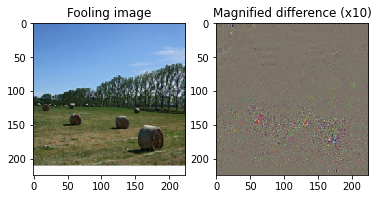

In [ ]:
# Testing field 
logits = squeeze(X_fooling)[0] # [0] to get the Tensor associated to the only input image in the "batch"
while logits.argmax().item() != target_y:
  # Keep on trying to fool the model
  logits = squeeze(X_fooling)[0]
  logit = logits[target_y]
  logit.backward() # Backpropagating only the target class' score
  X_fooling.data += X_fooling.grad / X_fooling.grad.norm() * 0.1 # Modifying the input accordingly w/ a learning rate
  X_fooling.grad.zero_()

plt.subplot(1,2,1)
plt.imshow(np.asarray(deprocess(X_fooling.clone())).astype(np.uint8))
plt.title("Fooling image")
plt.subplot(1,2,2)
plt.imshow(np.asarray(deprocess(10*(X_fooling - X_tensor), should_rescale=False)))
plt.title("Magnified difference (x10)")
plt.show()

In [ ]:
def make_fooling_image(X, target_y, model, learning_rate):
    """
    Generate a fooling image that is close to X, but that the model classifies
    as target_y.
    Inputs:
    - X: Input image; Tensor of shape (1, 3, 224, 224)
    - target_y: An integer in the range [0, 1000)
    - model: A pretrained CNN
    Returns:
    - X_fooling: An image that is close to X, but that is classifed as target_y
    by the model.
    """
    # Initialize our fooling image to the input image, enable gradients.
    X_fooling = X.clone()
    X_fooling.requires_grad = True
    ##############################################################################
    # TODO: Generate a fooling image X_fooling that the model will classify as   #
    # the class target_y. You should perform gradient ascent on the score of the #
    # target class, stopping when the model is fooled.                           #
    # When computing an update step, first normalize the gradient:               #
    #   dX = learning_rate * grad / ||grad||_2                                   #
    #                                                                            #
    # You should write a training loop.                                          #
    #                                                                            #
    # HINT: For most examples, you should be able to generate a fooling image    #
    # in fewer than 100 iterations of gradient ascent.                           #
    # You can print your progress over iterations to check your algorithm.       #
    # HINT: Remember to reset gradients at each step                             #
    # HINT: update shouldn't be tracked by the autograd (see for example         #
    # https://pytorch.org/tutorials/beginner/examples_autograd/two_layer_net_autograd.html#sphx-glr-beginner-examples-autograd-two-layer-net-autograd-py #
    ##############################################################################
    for i in range(100):
      logits = model(X_fooling)[0]
      if logits.argmax().item() == target_y:
        break
      logit = logits[target_y]
      logit.backward()
      # equiv X_fooling.data += X_fooling.grad / X_fooling.grad.norm() * 0.1
      with torch.no_grad():
        X_fooling += X_fooling.grad / X_fooling.grad.norm() * learning_rate
      X_fooling.grad.zero_()
    ##############################################################################
    #                             END OF YOUR CODE                               #
    ##############################################################################
    return X_fooling, i

def showFooling(idx,target_y,model,X=X,lr=1):
  # Indice de l'image à modifier et de la classe cible en argument
  # Préparation du tenseur X et sa version "fooling"
  X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
  X_fooling, i = make_fooling_image(X_tensor[idx:idx+1], target_y, model,lr)
  # Vérification de la classe prédite
  scores = model(X_fooling)
  # Affichage
  X_fooling_np = deprocess(X_fooling.clone())
  X_fooling_np = np.asarray(X_fooling_np).astype(np.uint8)
  plt.subplot(1, 4, 1)
  plt.imshow(X[idx])
  plt.title(class_names[y[idx]])
  plt.axis('off')
  plt.subplot(1, 4, 2)
  plt.imshow(X_fooling_np)
  plt.title(class_names[model(X_fooling)[0].argmax().item()]) # THIS WAS CHANGED - was class_names[target_y]
  plt.axis('off')
  plt.subplot(1, 4, 3)
  X_pre = preprocess(Image.fromarray(X[idx]))
  diff = np.asarray(deprocess(X_fooling - X_pre, should_rescale=False))
  plt.imshow(diff)
  plt.title('Difference after {} its'.format(i))
  plt.axis('off')
  plt.subplot(1, 4, 4)
  diff = np.asarray(deprocess(10 * (X_fooling - X_pre), should_rescale=False))
  plt.imshow(diff)
  plt.title('Magnified difference (10x)')
  plt.axis('off')
  plt.gcf().set_size_inches(12, 5)
  plt.show()
  
  # We chose to move the assertion to here,
  # to be able to visualise the result even though it didn't work in 100 its.
  # See the change in the image titles above
  assert target_y == scores.data.max(1)[1][0], 'The model is not fooled!'

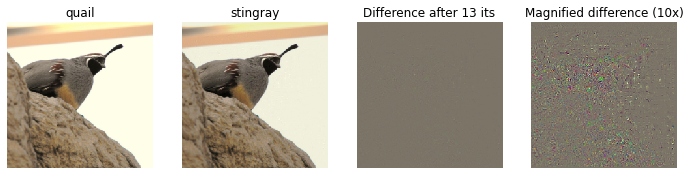

In [ ]:
  showFooling(1,class_names_to_id['stingray'],squeeze)

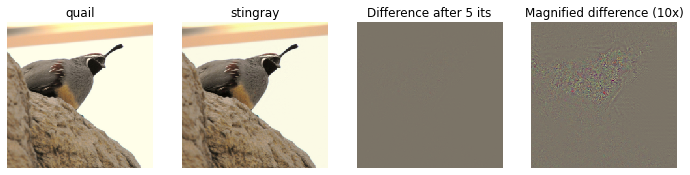

In [ ]:
showFooling(1,class_names_to_id['stingray'],vgg16)

### Bonus : essayez en changeant d'image et de classe target. 

On a également tenté de flouer VGG16, ce qui prend plus de temps et n'est pas toujours possible selon le learning_rate.

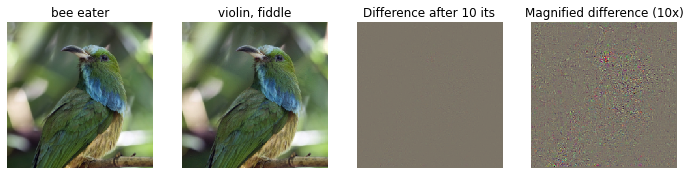

In [ ]:
showFooling(13,class_names_to_id['violin, fiddle'],squeeze)

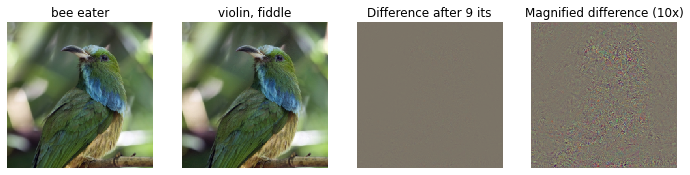

In [ ]:
showFooling(13,class_names_to_id['violin, fiddle'],vgg16)

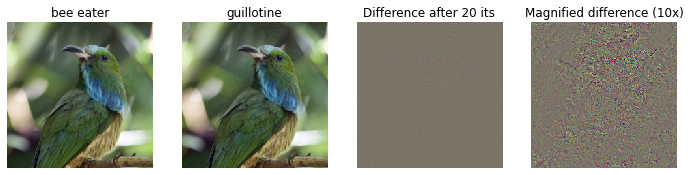

In [ ]:
showFooling(13,class_names_to_id['guillotine'],vgg16)
# Anything just works.

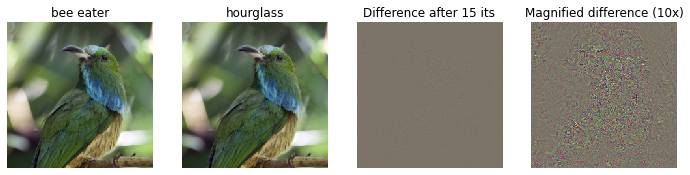

In [ ]:
showFooling(13,class_names_to_id['hourglass'],vgg16)
# ¯\_(ツ)_/¯

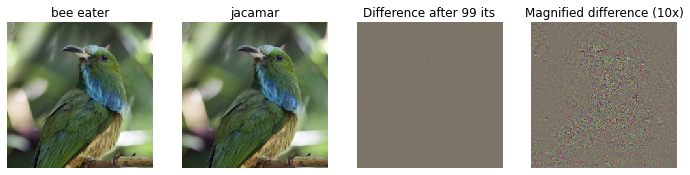

AssertionError: ignored

In [ ]:
showFooling(13,class_names_to_id['hourglass'],vgg16,lr=0.1)
# The learning rate is too low indeed.

### Transfert des attaques

Y a-t-il une façon facile pour nous d'effectuer une attaque sur un réseau non immédiatement disponible ?


In [ ]:
def make_fooling_certain(X, target_y, model, learning_rate):
    # Initialize our fooling image to the input image, enable gradients.
    X_fooling = X.clone()
    X_fooling.requires_grad = True
    print("\nSubstitute's network evolving confidence in this ↓ being a "+class_names[target_y]+":")
    for i in range(100):
      logits = model(X_fooling)[0]
      prob = (torch.exp(logits[target_y])/(1+torch.exp(logits[target_y]))).item()
      print(prob)
      if logits.argmax().item() == target_y and prob > 0.9:
        # Notice that we need to fulfil another condition on the model's confidence before we stop the procedure
        break
      logit = logits[target_y]
      logit.backward()
      with torch.no_grad():
        X_fooling += X_fooling.grad / X_fooling.grad.norm() * learning_rate
      X_fooling.grad.zero_()
    return X_fooling, i

def transferFooling(idx,target_y,model1,model2,X=X, lr=1):
  X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
  X_fooling, i = make_fooling_certain(X_tensor[idx:idx+1], target_y, model1, lr)
  scores = model1(X_fooling)
  X_fooling_np = deprocess(X_fooling.clone())
  X_fooling_np = np.asarray(X_fooling_np).astype(np.uint8)
  plt.subplot(1, 4, 1)
  plt.imshow(X[idx])
  plt.title("Original is "+class_names[y[idx]])
  plt.axis('off')
  plt.subplot(1, 4, 2)
  plt.imshow(X_fooling_np)
  plt.title("Target network says "+class_names[model2(X_fooling)[0].argmax().item()])
  plt.axis('off')
  plt.subplot(1, 4, 3)
  X_pre = preprocess(Image.fromarray(X[idx]))
  diff = np.asarray(deprocess(X_fooling - X_pre, should_rescale=False))
  plt.imshow(diff)
  plt.title('Difference after {} its'.format(i))
  plt.axis('off')
  plt.subplot(1, 4, 4)
  diff = np.asarray(deprocess(10 * (X_fooling - X_pre), should_rescale=False))
  plt.imshow(diff)
  plt.title('Magnified difference (10x)')
  plt.axis('off')
  plt.gcf().set_size_inches(12, 5)
  plt.show()

  if model2(X_fooling)[0].argmax().item() != target_y:
    print("\nThe fooling went well but the transfer failed.")
  
  assert target_y == scores.data.max(1)[1][0], 'The model is not fooled!'


Substitute's network evolving confidence in this ↓ being a stingray:
0.8038904070854187
0.9947041273117065
0.9999365210533142
0.9999998211860657
1.0


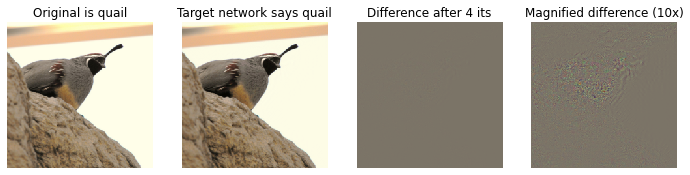


The fooling went well but the transfer failed.


In [ ]:
transferFooling(1,class_names_to_id['stingray'],vgg19,vgg16,lr=1)

C'est pleinement compréhensible car même s'ils reposent sur le même principe, VGG19 et VGG16 diffèrent notamment en profondeur et doivent produire des frontières de décision assez différentes. Il faut construire le modèle de substitution autrement :   
https://arxiv.org/abs/1809.02861  
https://arxiv.org/pdf/1602.02697  

Notons par ailleurs l'incroyable confiance du modèle dans sa fausse prédiction. Ce chiffre a été étudié pour cette fonctionnalité et n'avait pas été affiché plus haut.

## Class Visualization

Ecrire le code permettant de calculer une image maximisant le score d'une classe, sujet à un certain nombre de régularisations.

In [ ]:
def create_class_visualization(target_y, model, dtype, init_img=None, l2_reg=1e-3, learning_rate=5,
                               num_iterations=200, blur_every=10, max_jitter=16, show_every=25):
    """
    Generate an image to maximize the score of target_y under a pretrained model.
    Inputs:
    - target_y: Integer in the range [0, 1000) giving the index of the class
    - model: A pretrained CNN that will be used to generate the image
    - dtype: Torch datatype to use for computations
    
    Keyword arguments:
    - init_img: Initial image to use (if None, will be random)
    - l2_reg: Strength of L2 regularization on the image
    - learning_rate: How big of a step to take
    - num_iterations: How many iterations to use
    - blur_every: How often to blur the image as an implicit regularizer
    - max_jitter: How much to gjitter the image as an implicit regularizer
    - show_every: How often to show the intermediate result
    """
    model.type(dtype)

    # Randomly initialize the image as a PyTorch Tensor
    if init_img is None:
        img = torch.randn(1, 3, 224, 224).mul_(1.0).type(dtype).detach()
    else:
        img = init_img.clone().mul_(1.0).type(dtype).detach()
    img.requires_grad = True

    for t in range(num_iterations):
        # Randomly jitter the image a bit; this gives slightly nicer results
        ox, oy = random.randint(0, max_jitter), random.randint(0, max_jitter)
        img = (jitter(img, ox, oy)).clone().detach()
        img.requires_grad = True

        ########################################################################
        # - TODO: Use the model to compute the gradient of the score for the   #
        # class target_y with respect to the pixels of the image, and make a   #
        # gradient step on the image using the learning rate. Don't forget the #
        # L2 regularization term!                                              #
        # - Be very careful about the signs of elements in your code.          #
        # - Advice: compute backward on the raw logits (not the loss), it      #
        # works better                                                         #
        ########################################################################
        logits = model(img)
        logit = logits[0,target_y]
        loss = -logit + l2_reg * torch.norm(img)
        # loss = F.cross_entropy(logits[None],targets_y) + l2_reg * torch.norm(img)
        loss.backward()
        with torch.no_grad():
          dx = img.grad
          img -= learning_rate * dx
          img.grad.zero_()
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################
        
        # Undo the random jitter
        img.data.copy_(jitter(img, -ox, -oy))

        # As regularizer, clamp and periodically blur the image
        for c in range(3):
            lo = float(-SQUEEZENET_MEAN[c] / SQUEEZENET_STD[c])
            hi = float((1.0 - SQUEEZENET_MEAN[c]) / SQUEEZENET_STD[c])
            img[:, c].clamp_(min=lo, max=hi)
        if t % blur_every == 0:
            blur_image(img, sigma=0.5)
        
        # Periodically show the image
        if t == 0 or (t + 1) % show_every == 0 or t == num_iterations - 1:
            plt.imshow(deprocess(img.clone().cpu()))
            class_name = class_names[target_y]
            plt.title('%s\nIteration %d / %d' % (class_name.split(',')[0], t + 1, num_iterations))
            plt.gcf().set_size_inches(4, 4)
            plt.axis('off')
            plt.show()

    return deprocess(img.cpu())

#### Sans image

Test avec diverses classes en partant d'un bruit aléatoire.

In [ ]:
model = squeeze
dtype = torch.cuda.FloatTensor
model.type(dtype)

SqueezeNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (3): Fire(
      (squeeze): Conv2d(64, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (4): Fire(
      (squeeze): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (5): MaxPool2d

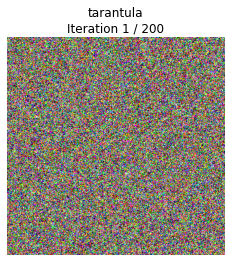

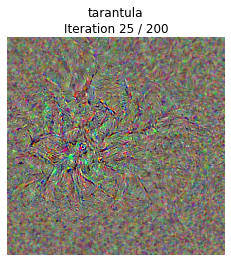

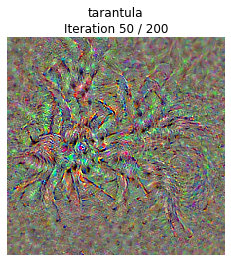

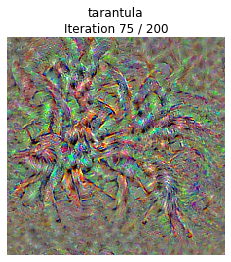

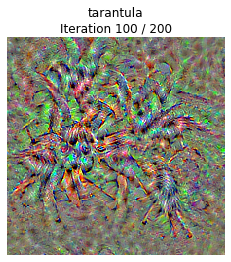

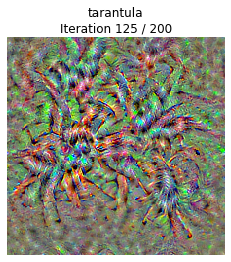

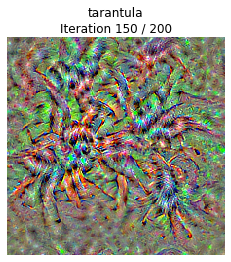

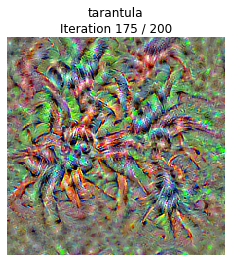

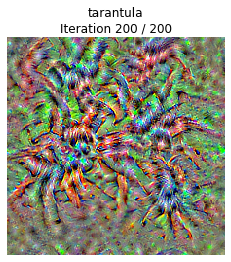

In [ ]:
target_y = 76 # Tarantula
out = create_class_visualization(target_y, model, dtype, show_every=25, num_iterations=200)

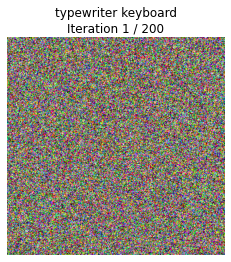

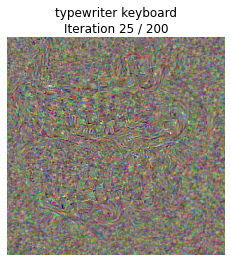

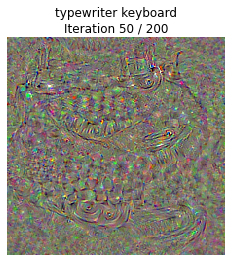

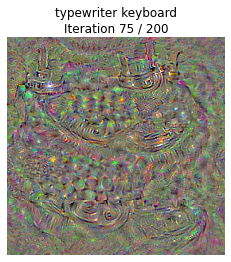

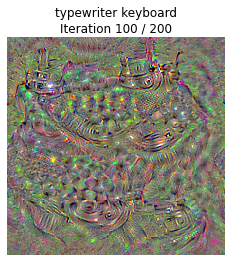

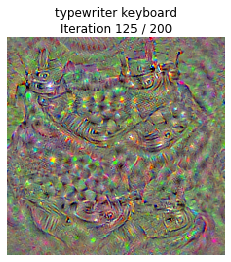

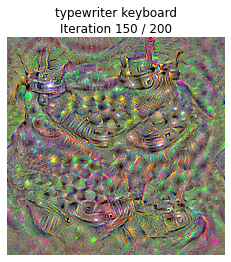

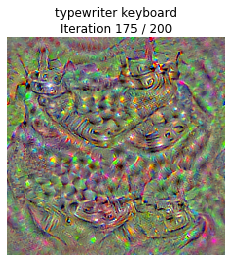

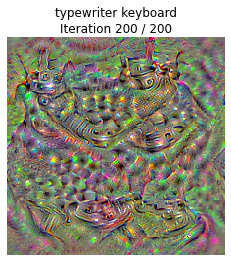

In [ ]:
target_y = 878 # Typewriter keyboard
out = create_class_visualization(target_y, model, dtype, show_every=25, num_iterations=200)

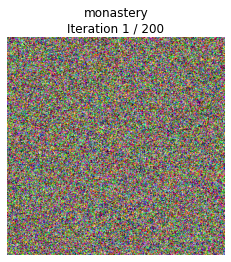

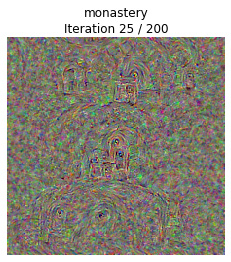

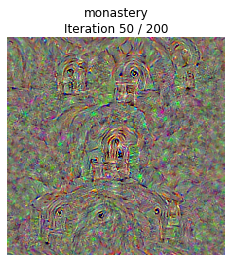

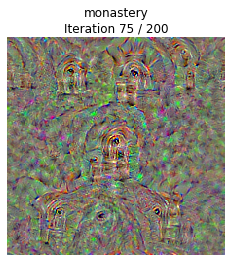

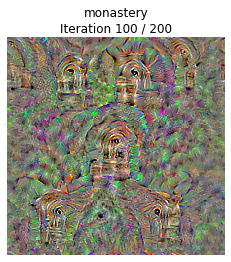

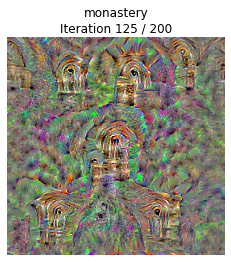

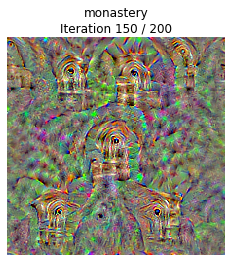

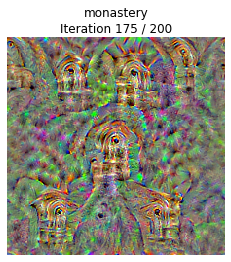

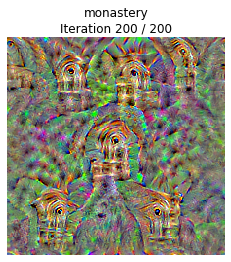

In [ ]:
target_y = 663 # Monastery
out = create_class_visualization(target_y, model, dtype, show_every=25, num_iterations=200)

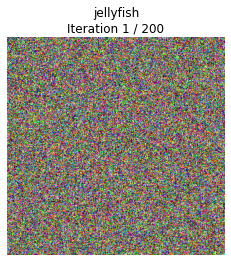

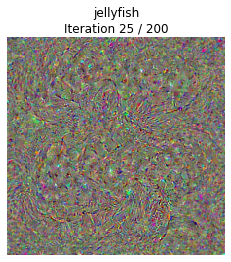

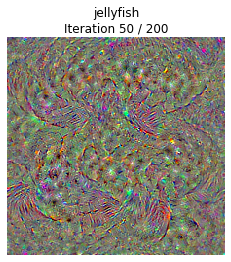

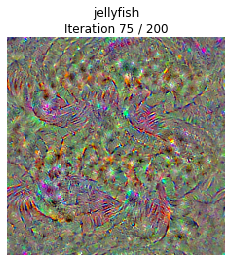

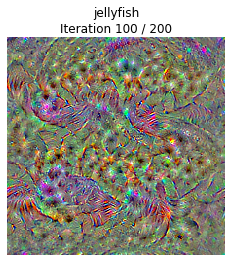

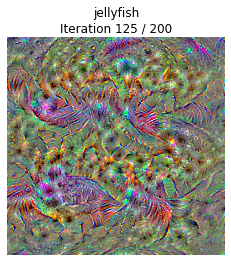

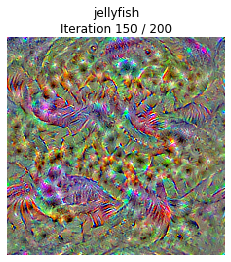

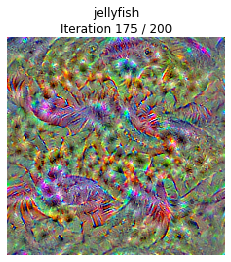

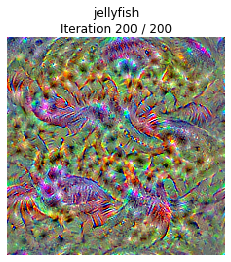

In [ ]:
target_y = 107 # Jellyfish
out = create_class_visualization(target_y, model, dtype, show_every=25, num_iterations=200)

In [ ]:
target_y = 145 # Penguin
# Iteration num. study
out = create_class_visualization(target_y, model, dtype, show_every=25, learning_rate = 2, l2_reg = 0.000001, num_iterations=500)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
target_y = 604 # Hourglass
# Learning_rate variation
out = create_class_visualization(target_y, model, dtype, learning_rate = 10, show_every=100, num_iterations=200)
out = create_class_visualization(target_y, model, dtype, learning_rate = 5, show_every=100, num_iterations=200)
out = create_class_visualization(target_y, model, dtype, learning_rate = 2, show_every=100, num_iterations=200)
out = create_class_visualization(target_y, model, dtype, learning_rate = 0.5, show_every=100, num_iterations=200)

Output hidden; open in https://colab.research.google.com to view.

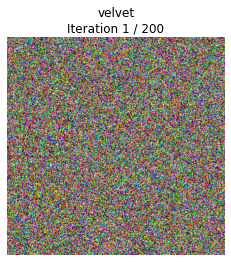

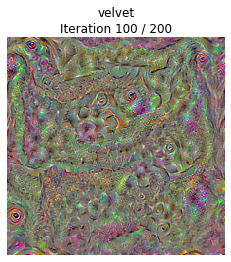

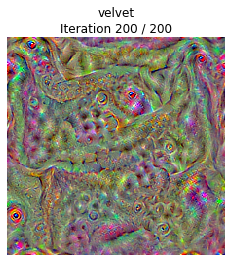

In [ ]:
target_y = np.random.randint(1000) # Random stuff
out = create_class_visualization(target_y, model, dtype, show_every=100, num_iterations=200)

#### Avec une image

Test en partant d'une image d'ImageNet.

In [ ]:
model = squeeze
dtype = torch.cuda.FloatTensor
model.type(dtype)

SqueezeNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (3): Fire(
      (squeeze): Conv2d(64, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (4): Fire(
      (squeeze): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (5): MaxPool2d

In [ ]:
img_ind = 12 # Pirate ship
target_y = 724 # Pirate ship 
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.00001, show_every=100, num_iterations=300)
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.1, show_every=100, num_iterations=300)
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.5, show_every=100, num_iterations=300)
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=1, show_every=100, num_iterations=300)

Output hidden; open in https://colab.research.google.com to view.

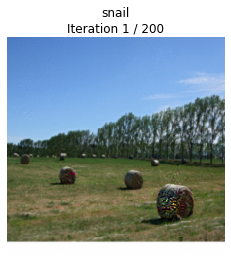

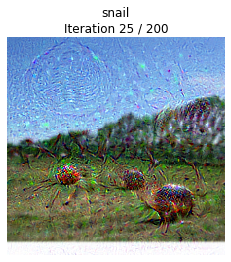

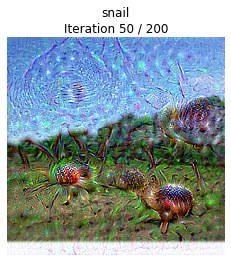

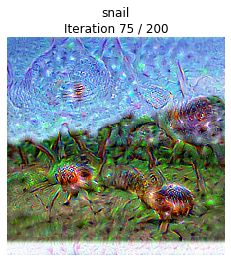

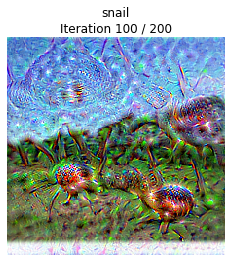

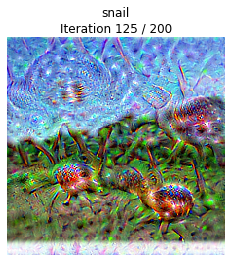

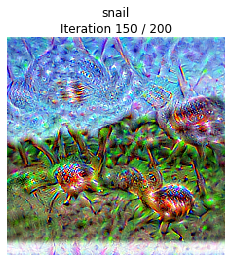

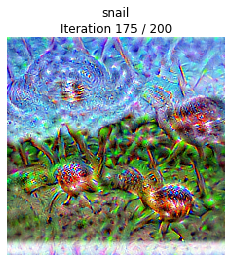

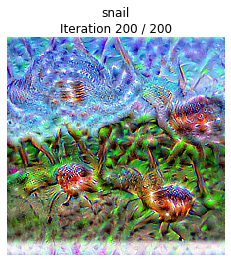

In [ ]:
img_ind = 0 # Hay
target_y = 113 # Snail
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, show_every=25, num_iterations=200)

In [ ]:
img_ind = 13 # Bee eater
target_y = 24 # Owl
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.1, show_every=25, num_iterations=300)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
img_ind = 10 # Stole
target_y = 1 # Goldfish
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.001, show_every=25, num_iterations=300)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
img_ind = 20 # Daisy
target_y = 89 # Cockatoo
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.1, show_every=25, num_iterations=300)

Output hidden; open in https://colab.research.google.com to view.

#### Cas de VGG

In [ ]:
model = vgg16

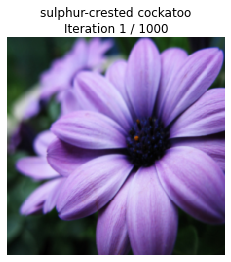

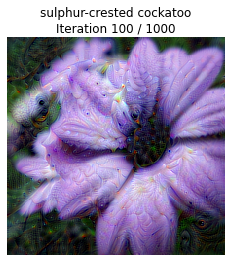

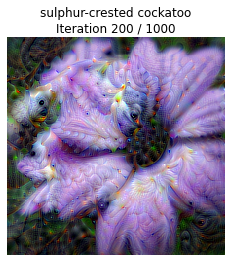

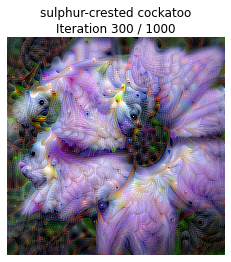

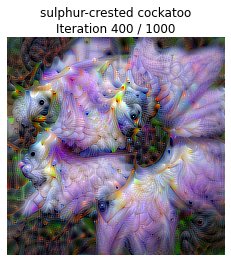

...

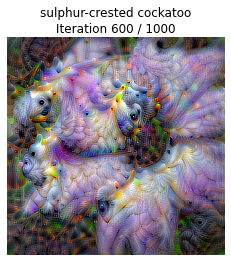

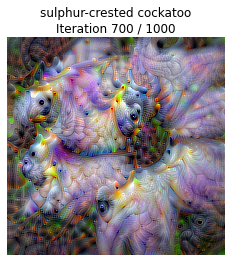

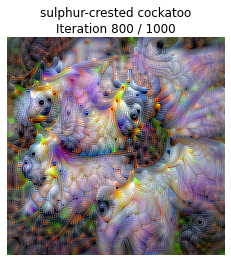

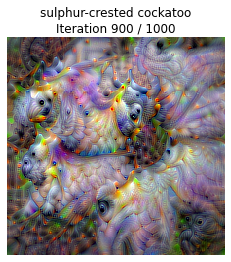

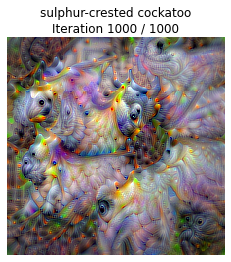

In [ ]:
img_ind = 20 # Daisy
target_y = 89 # Cockatoo
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.5, learning_rate=0.5, show_every=100, num_iterations=1000)

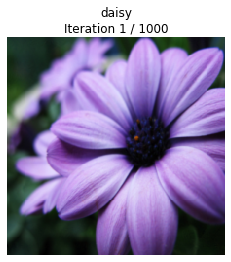

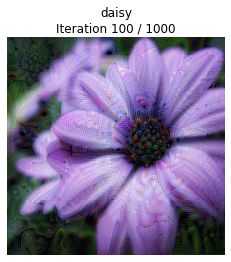

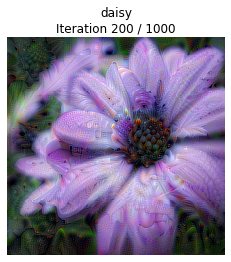

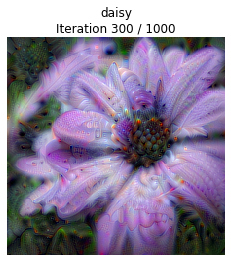

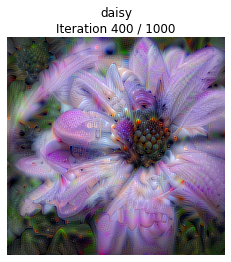

...

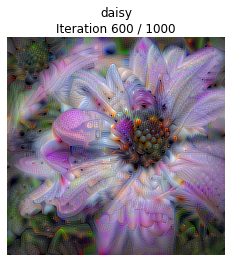

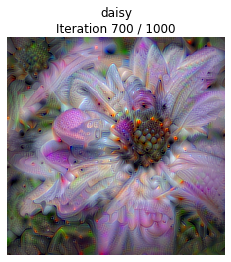

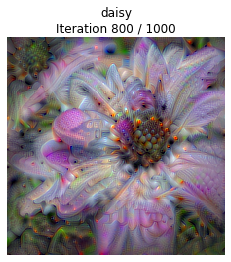

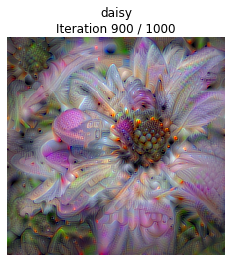

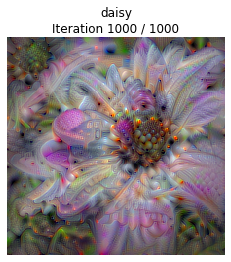

In [ ]:
img_ind = 20 # Daisy
target_y = class_names_to_id['daisy']
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.5, learning_rate=0.5, show_every=100, num_iterations=1000)

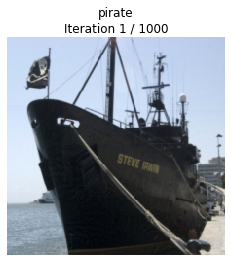

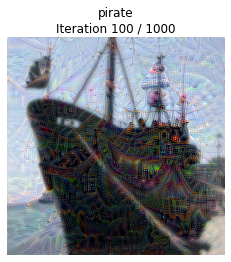

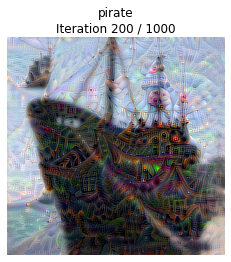

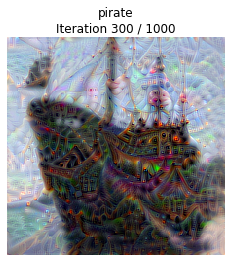

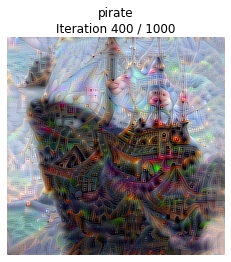

...

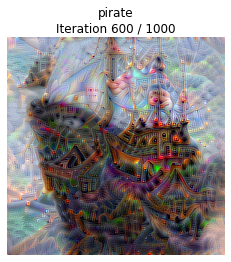

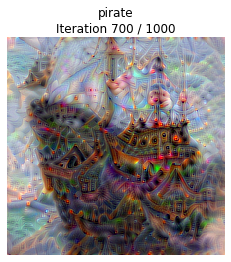

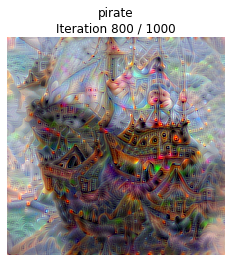

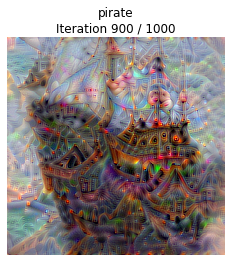

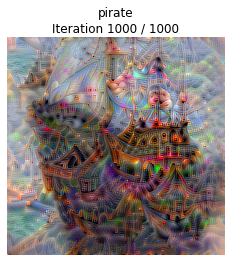

In [ ]:
img_ind = 12 # Pirate ship
target_y = 724 # Pirate ship 
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.5, learning_rate=0.5, show_every=100, num_iterations=1000)

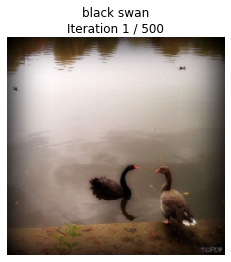

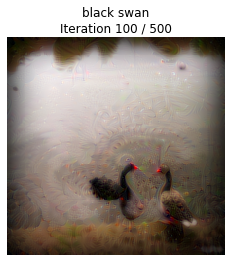

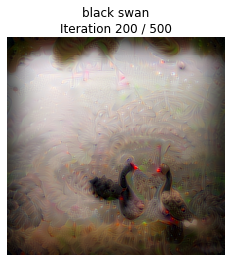

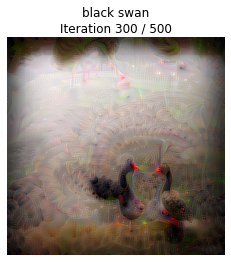

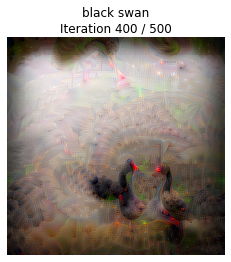

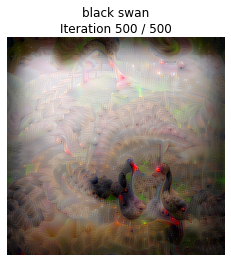

In [ ]:
img_ind = 24 # Black Swan
target_y = 100 # Black Swan 
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.1, learning_rate=0.1, show_every=100, num_iterations=500)

In [ ]:
img_ind = 17 # Cardigan corgi
target_y = 289 # Snow Panther 
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.1, learning_rate=1, show_every=100, num_iterations=1000)

Output hidden; open in https://colab.research.google.com to view.

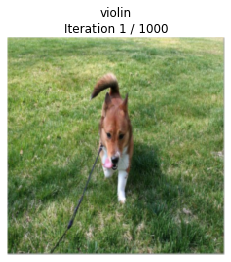

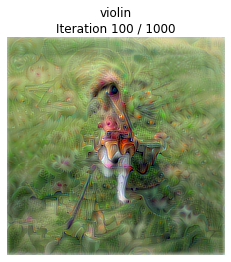

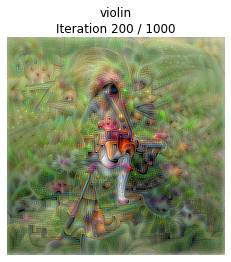

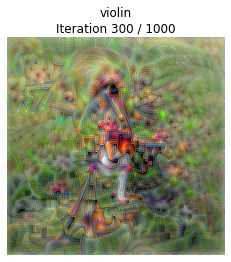

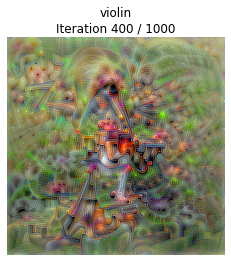

...

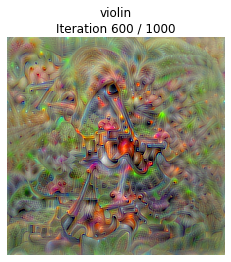

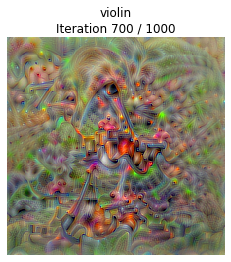

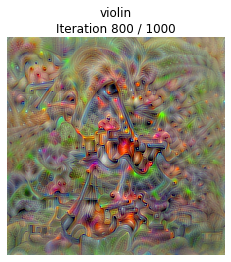

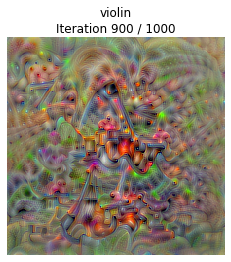

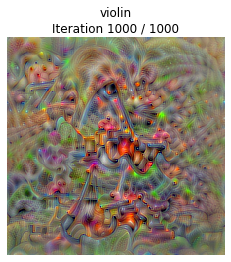

In [ ]:
img_ind = 17 # Cardigan corgi
target_y = 889 # Violin
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, l2_reg=0.5, learning_rate=0.5, show_every=100, num_iterations=1000)